# plot T-S at bottom and surface

For control, basal and basal LH for normal and SOFIA

Some code from https://github.com/pedrocol/basal_mom5-collaborative-project/blob/main/notebooks/comp_obs/bottom.ipynb

In [1]:
%matplotlib inline

import matplotlib.pyplot as plt
import numpy as np
import netCDF4 as nc
import cartopy.crs as ccrs
import xarray as xr
import cmocean as cm
import glob
import matplotlib.path as mpath
import matplotlib.colors as col

import logging
logging.captureWarnings(True)
logging.getLogger('py.warnings').setLevel(logging.ERROR)

from dask.distributed import Client


In [2]:
client = Client()
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: /proxy/34181/status,
Dashboard: /proxy/34181/status,Workers: 7
Total threads: 28,Total memory: 125.19 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:34777,Workers: 0
Dashboard: /proxy/34181/status,Total threads: 0
Started: Just now,Total memory: 0 B
Comm: tcp://127.0.0.1:40837,Total threads: 4
Dashboard: /proxy/40685/status,Memory: 17.88 GiB
Nanny: tcp://127.0.0.1:44823,


In [3]:
control                  = '/g/data/ik11/outputs/access-om2-01/01deg_jra55v13_ryf9091_21mbath'
control_SOFIA            = '/g/data/ik11/outputs/access-om2-01/01deg_jra55v13_ryf9091_21mbath_sofia_ssp126'
basal           = '/g/data/ik11/outputs/access-om2-01/01deg_jra55v13_ryf9091_DSW_BasalNoGade_NoIcb'
basal_SOFIA              = '/g/data/ik11/outputs/access-om2-01/01deg_jra55v13_ryf9091_DSW_BasalNoGade_NoIcb_sofia_ssp126'
basal_LH_brine           = '/g/data/ik11/outputs/access-om2-01/01deg_jra55v13_ryf9091_DSW_BasalGade_NoIcb_Brine_rep'
basal_LH_brine_SOFIA     = '/g/data/ik11/outputs/access-om2-01/01deg_jra55v13_ryf9091_DSW_BasalGade_NoIcb_Brine_sofia_ssp126'

Check which folders have year 20

In [4]:
!cat /g/data/ik11/outputs/access-om2-01/01deg_jra55v13_ryf9091_21mbath/output077/ocean/time_stamp.out
!cat /g/data/ik11/outputs/access-om2-01/01deg_jra55v13_ryf9091_21mbath/output081/ocean/time_stamp.out

1918  11   1   0   0   0  Nov
1919   2   1   0   0   0  Feb
1919  11   1   0   0   0  Nov
1920   2   1   0   0   0  Feb


In [5]:
!cat /g/data/ik11/outputs/access-om2-01/01deg_jra55v13_ryf9091_21mbath_sofia_ssp126/output078/ocean/time_stamp.out
!cat /g/data/ik11/outputs/access-om2-01/01deg_jra55v13_ryf9091_21mbath_sofia_ssp126/output083/ocean/time_stamp.out

1919   1   1   0   0   0  Jan
1919   3   1   0   0   0  Mar
1919  11   1   0   0   0  Nov
1920   1   1   0   0   0  Jan


In [6]:
!cat /g/data/ik11/outputs/access-om2-01/01deg_jra55v13_ryf9091_DSW_BasalNoGade_NoIcb/output157/ocean/time_stamp.out
!cat /g/data/ik11/outputs/access-om2-01/01deg_jra55v13_ryf9091_DSW_BasalNoGade_NoIcb/output161/ocean/time_stamp.out

1918  11   1   0   0   0  Nov
1919   2   1   0   0   0  Feb
1919  11   1   0   0   0  Nov
1920   1   1   0   0   0  Jan


In [7]:
!cat /g/data/ik11/outputs/access-om2-01/01deg_jra55v13_ryf9091_DSW_BasalNoGade_NoIcb_sofia_ssp126/output156/ocean/time_stamp.out
!cat /g/data/ik11/outputs/access-om2-01/01deg_jra55v13_ryf9091_DSW_BasalNoGade_NoIcb_sofia_ssp126/output160/ocean/time_stamp.out

1918  11   1   0   0   0  Nov
1919   2   1   0   0   0  Feb
1919  11   1   0   0   0  Nov
1920   1   1   0   0   0  Jan


In [8]:
!cat /g/data/ik11/outputs/access-om2-01/01deg_jra55v13_ryf9091_DSW_BasalGade_NoIcb_Brine_rep/output083/ocean/time_stamp.out
!cat /g/data/ik11/outputs/access-om2-01/01deg_jra55v13_ryf9091_DSW_BasalGade_NoIcb_Brine_rep/output088/ocean/time_stamp.out

1919   1   1   0   0   0  Jan
1919   3   1   0   0   0  Mar
1919  11   1   0   0   0  Nov
1920   1   1   0   0   0  Jan


In [9]:
!cat /g/data/ik11/outputs/access-om2-01/01deg_jra55v13_ryf9091_DSW_BasalGade_NoIcb_Brine_sofia_ssp126/output096/ocean/time_stamp.out
!cat /g/data/ik11/outputs/access-om2-01/01deg_jra55v13_ryf9091_DSW_BasalGade_NoIcb_Brine_sofia_ssp126/output102//ocean/time_stamp.out

1918  12   1   0   0   0  Dec
1919   2   1   0   0   0  Feb
1919  12   1   0   0   0  Dec
1920   1   1   0   0   0  Jan


In [4]:
# define an index to open files covering year 20 (1919)
year_20_index = {'control': {'path':control,'start':77,'end':81},
                 'control_SOFIA':{'path':control_SOFIA,'start':78,'end':83},
                 'basal':{'path':basal,'start':157,'end':161},
                 'basal_SOFIA':{'path':basal_SOFIA,'start':156,'end':160},
                 'basal_LH_brine':{'path':basal_LH_brine,'start':83,'end':88},
                 'basal_LH_brine_SOFIA':{'path':basal_LH_brine_SOFIA,'start':96,'end':102},
                }

In [5]:
#function to load ocean.nc across year 2020
def load_ocean_yr20(expt):
    base = year_20_index[expt]['path']
    start = year_20_index[expt]['start']
    end = year_20_index[expt]['end']
    list_outputs = np.arange(start, end + 1)
    c = []
    for i in range(len(list_outputs)): 
        c.append(i)
        c[i] = base+'/output'+str(list_outputs[i]).zfill(3) + '/ocean/ocean.nc' 
    ocean_yr20 = xr.open_mfdataset(c,combine='by_coords',decode_times = True, decode_timedelta = False, parallel = True)
    ocean_yr20 = ocean_yr20.sel(time = slice('1919-01-01','1919-12-31'))
    print('check year 20 has 12 months: no months = ', len(ocean_yr20.time))
    return ocean_yr20

In [6]:
# topography data for plotting:
ht = xr.open_dataset('/g/data/ik11/outputs/access-om2-01/01deg_jra55v13_ryf9091_21mbath/output000/ocean/ocean_grid.nc').ht
land_mask = np.squeeze(ht.values)*0
land_mask[np.isnan(land_mask)] = 1
land_mask = np.where(land_mask==1,land_mask,np.nan)
land_mask_masked = np.ma.masked_where((land_mask==0),land_mask)
# make land go all the way to -90S:
land_mask_lat = ht.yt_ocean.values
land_mask_lat[0] = -90


##### Define plotting functions for T and S averaged over year 20
including anomaly plots

In [7]:
def plot_circumpolar_map_mean_T(ax, expt, vmax, vmin, depth = 0, anomaly = False, ref = None, refname = None):
    ## depth is either 'bottom' or a depth value
    lat_range = slice(-90,-30)
    ocean_yr20 = load_ocean_yr20(expt)
    
    if depth != 'bottom':
        mean_temp = ocean_yr20.temp.sel(yt_ocean = lat_range).sel(st_ocean = depth, method = 'nearest').mean('time')
    else:
        mean_temp_3d = ocean_yr20.temp.sel(yt_ocean = lat_range).mean('time')
        depth_array = mean_temp_3d * 0 + mean_temp_3d.st_ocean
        # select out bottom values:
        max_depth = depth_array.max(dim = 'st_ocean', skipna= True)
        mean_temp = mean_temp_3d.where(depth_array.st_ocean >= max_depth).sum(dim = 'st_ocean')
        
    mean_temp = mean_temp.load() - 273.15 #convert to celcius

    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    # plot:
    if anomaly:
        cf = ax.pcolormesh(mean_temp.xt_ocean, mean_temp.yt_ocean, mean_temp - ref, vmin = vmin, vmax = vmax,
                           cmap = cm.cm.balance, transform = ccrs.PlateCarree())
        ax.set_title(expt+' - '+refname)
        # colorbar:
        cbar = plt.colorbar(cf, ax = ax, orientation = 'vertical',extend = 'both')
        cbar.set_label(r'Temperature anomaly ($^\circ$C)',labelpad=2)
    else:
        cf = ax.pcolormesh(mean_temp.xt_ocean, mean_temp.yt_ocean, mean_temp, vmin = vmin, vmax = vmax,
                           cmap = cm.cm.thermal, transform = ccrs.PlateCarree())
        ax.set_title(expt)
        # colorbar:
        cbar = plt.colorbar(cf, ax = ax, orientation = 'vertical',extend = 'both')
        cbar.set_label(r'Temperature ($^\circ$C)',labelpad=2)
        
    ax.contour(ht.xt_ocean,ht.yt_ocean,ht,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
    ax.pcolormesh(ht.xt_ocean, land_mask_lat,land_mask_masked,cmap = 'Greys', vmin = 0, vmax = 3,
                 zorder=2,transform = ccrs.PlateCarree())
    ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())
    
    
    return mean_temp

In [11]:
def plot_circumpolar_map_mean_S(ax, expt, vmax, vmin, depth = 0, anomaly = False, ref = None, refname = None):
    ## depth is either 'bottom' or a depth value
    lat_range = slice(-90,-30)
    ocean_yr20 = load_ocean_yr20(expt)
    
    if depth != 'bottom':
        mean_salt = ocean_yr20.salt.sel(yt_ocean = lat_range).sel(st_ocean = depth, method = 'nearest').mean('time')
    else:
        mean_salt_3d = ocean_yr20.salt.sel(yt_ocean = lat_range).mean('time')
        depth_array = mean_salt_3d * 0 + mean_salt_3d.st_ocean
        # select out bottom values:
        max_depth = depth_array.max(dim = 'st_ocean', skipna= True)
        mean_salt = mean_salt_3d.where(depth_array.st_ocean >= max_depth).sum(dim = 'st_ocean')
        
    mean_salt = mean_salt.load() 

    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    # plot:
    if anomaly:
        cf = ax.pcolormesh(mean_salt.xt_ocean, mean_salt.yt_ocean, mean_salt - ref, vmin = vmin, vmax = vmax,
                           cmap = cm.cm.balance, transform = ccrs.PlateCarree())
        ax.set_title(expt+' - '+refname)
        # colorbar:
        cbar = plt.colorbar(cf, ax = ax, orientation = 'vertical',extend = 'both')
        cbar.set_label(r'Salinity anomaly',labelpad=2)
    else:
        cf = ax.pcolormesh(mean_salt.xt_ocean, mean_salt.yt_ocean, mean_salt, vmin = vmin, vmax = vmax,
                           cmap = cm.cm.haline, transform = ccrs.PlateCarree())
        ax.set_title(expt)
        # colorbar:
        cbar = plt.colorbar(cf, ax = ax, orientation = 'vertical',extend = 'both')
        cbar.set_label(r'Salinity',labelpad=2)
        
    ax.contour(ht.xt_ocean,ht.yt_ocean,ht,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
    ax.pcolormesh(ht.xt_ocean, land_mask_lat,land_mask_masked,cmap = 'Greys', vmin = 0, vmax = 3,
                 zorder=2,transform = ccrs.PlateCarree())
    ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())
    
    
    return mean_salt

## Surface Temperature

check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12


Text(0.5, 0.98, 'Surface temperature in year 20')

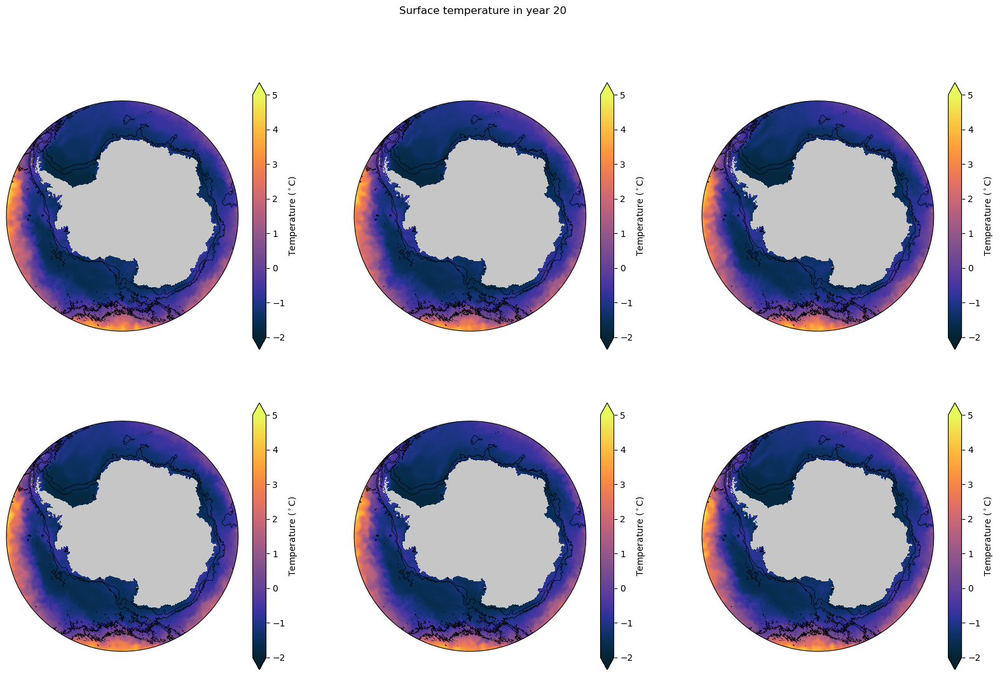

In [20]:
fig, axes = plt.subplots(nrows = 2, ncols = 3, figsize = (20,12),subplot_kw=dict(projection=ccrs.SouthPolarStereo()), dpi = 300)
plot_circumpolar_map_mean_T(axes[0,0], 'control', 5, -2)
plot_circumpolar_map_mean_T(axes[1,0], 'control_SOFIA', 5, -2)
plot_circumpolar_map_mean_T(axes[0,1], 'basal', 5, -2)
plot_circumpolar_map_mean_T(axes[1,1], 'basal_SOFIA', 5, -2)
plot_circumpolar_map_mean_T(axes[0,2], 'basal_LH_brine', 5, -2)
plot_circumpolar_map_mean_T(axes[1,2], 'basal_LH_brine_SOFIA', 5, -2)

fig.suptitle('Surface temperature in year 20')

check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12


Text(0.5, 0.98, 'Surface temperature in year 20')

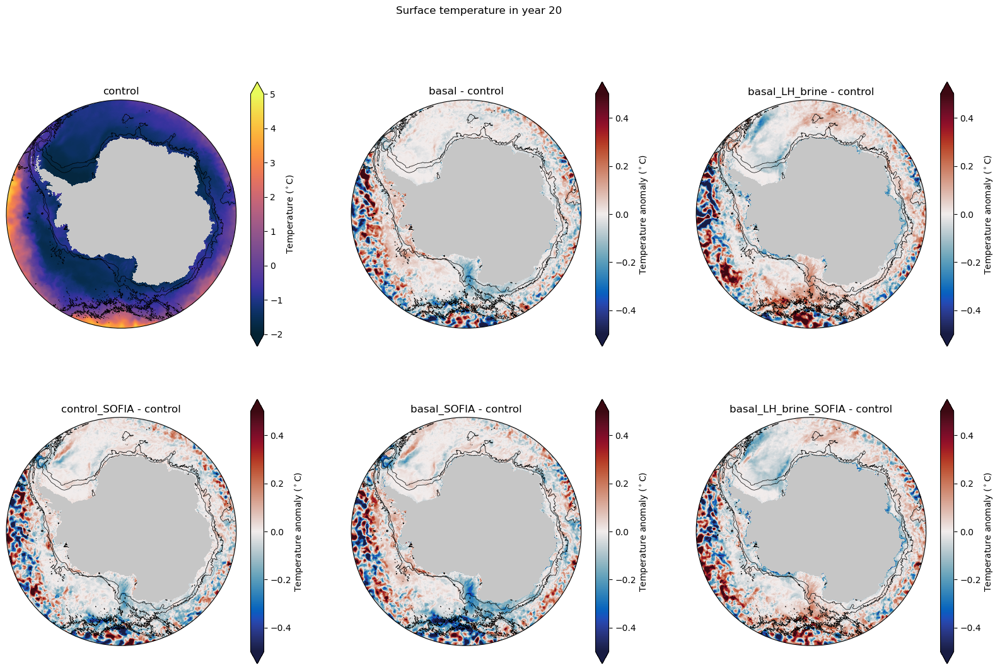

In [12]:
fig, axes = plt.subplots(nrows = 2, ncols = 3, figsize = (20,12),subplot_kw=dict(projection=ccrs.SouthPolarStereo()), dpi = 300)
control_temp = plot_circumpolar_map_mean_T(axes[0,0], 'control', 5, -2)
plot_circumpolar_map_mean_T(axes[1,0], 'control_SOFIA', 0.5, -0.5, anomaly = True, ref = control_temp, refname = 'control')
plot_circumpolar_map_mean_T(axes[0,1], 'basal', 0.5, -0.5, anomaly = True, ref = control_temp, refname = 'control')
plot_circumpolar_map_mean_T(axes[1,1], 'basal_SOFIA', 0.5, -0.5, anomaly = True, ref = control_temp, refname = 'control')
plot_circumpolar_map_mean_T(axes[0,2], 'basal_LH_brine', 0.5, -0.5, anomaly = True, ref = control_temp, refname = 'control')
plot_circumpolar_map_mean_T(axes[1,2], 'basal_LH_brine_SOFIA', 0.5, -0.5, anomaly = True, ref = control_temp, refname = 'control')

fig.suptitle('Surface temperature in year 20')

In [ ]:
fig, axes = plt.subplots(nrows = 2, ncols = 3, figsize = (20,12),subplot_kw=dict(projection=ccrs.SouthPolarStereo()), dpi = 300)
control_temp = plot_circumpolar_map_mean_T(axes[0,0], 'control', 5, -2)
plot_circumpolar_map_mean_T(axes[1,0], 'control_SOFIA', 0.5, -0.5, anomaly = True, ref = control_temp, refname = 'control')
basal_temp = plot_circumpolar_map_mean_T(axes[0,1], 'basal', 0.5, -0.5, anomaly = True, ref = control_temp, refname = 'control')
plot_circumpolar_map_mean_T(axes[1,1], 'basal_SOFIA', 0.5, -0.5, anomaly = True, ref = basal_temp, refname = 'basal')
basal_LH_brine_temp =plot_circumpolar_map_mean_T(axes[0,2], 'basal_LH_brine', 0.5, -0.5, anomaly = True, ref = control_temp, refname = 'control')
plot_circumpolar_map_mean_T(axes[1,2], 'basal_LH_brine_SOFIA', 0.5, -0.5, anomaly = True, ref = basal_LH_brine_temp, refname = 'basal_LH_brine')

fig.suptitle('Surface temperature in year 20')

check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12


Text(0.5, 0.98, 'Surface temperature in year 20')

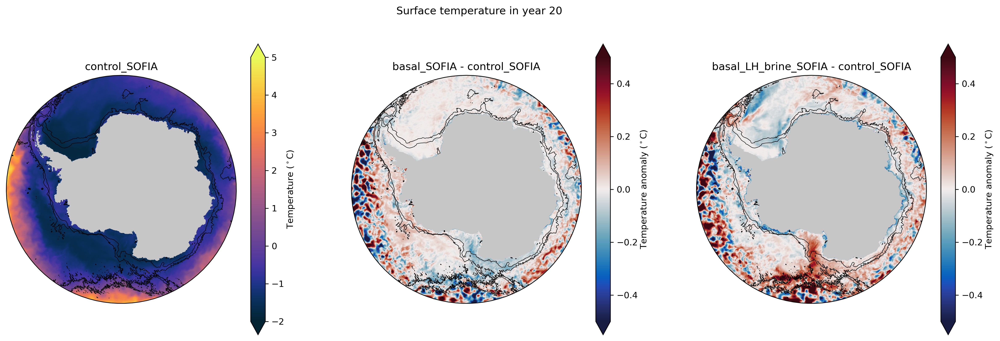

In [13]:
fig, axes = plt.subplots(nrows = 1, ncols = 3, figsize = (20,6),subplot_kw=dict(projection=ccrs.SouthPolarStereo()), dpi = 300)
control_temp_SOFIA = plot_circumpolar_map_mean_T(axes[0], 'control_SOFIA', 5, -2)
plot_circumpolar_map_mean_T(axes[1], 'basal_SOFIA', 0.5, -0.5, anomaly = True, ref = control_temp_SOFIA, refname = 'control_SOFIA')
plot_circumpolar_map_mean_T(axes[2], 'basal_LH_brine_SOFIA', 0.5, -0.5, anomaly = True, ref = control_temp_SOFIA, refname = 'control_SOFIA')

fig.suptitle('Surface temperature in year 20')

## Bottom Temperature

check year 20 has 12 months: no months =  12


/g/data/xp65/public/apps/med_conda/envs/analysis3-25.07/lib/python3.11/site-packages/dask/array/reductions.py:324: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/g/data/xp65/public/apps/med_conda/envs/analysis3-25.07/lib/python3.11/site-packages/dask/array/reductions.py:324: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12


Text(0.5, 0.98, 'Bottom temperature in year 20')

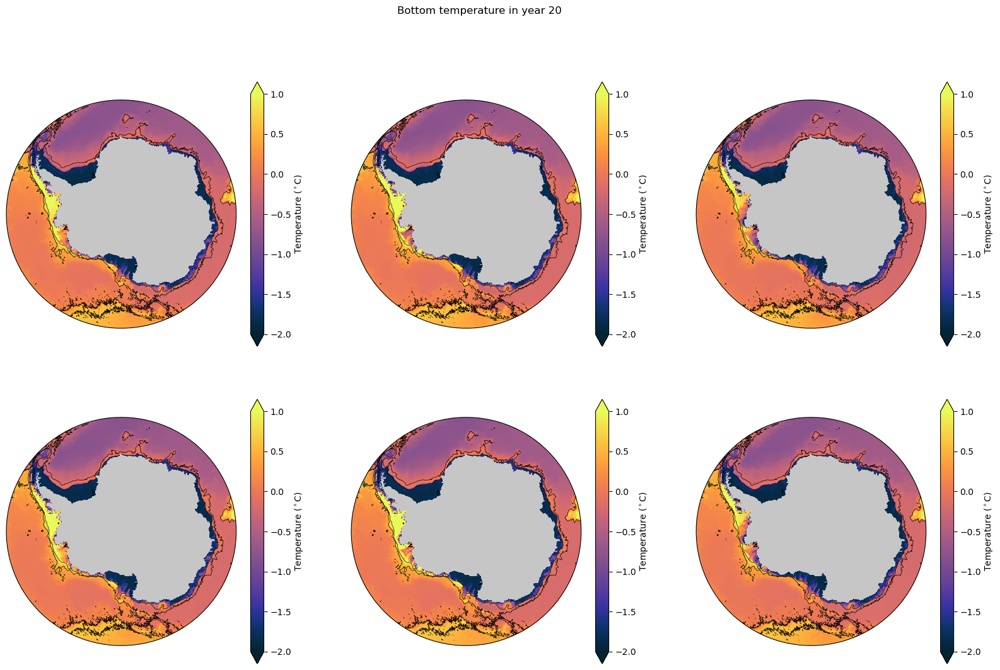

In [21]:
fig, axes = plt.subplots(nrows = 2, ncols = 3, figsize = (20,12),subplot_kw=dict(projection=ccrs.SouthPolarStereo()), dpi = 300)
plot_circumpolar_map_mean_T(axes[0,0], 'control', 1, -2, depth ='bottom')
plot_circumpolar_map_mean_T(axes[1,0], 'control_SOFIA', 1, -2, depth ='bottom')
plot_circumpolar_map_mean_T(axes[0,1], 'basal', 1, -2, depth ='bottom')
plot_circumpolar_map_mean_T(axes[1,1], 'basal_SOFIA', 1, -2, depth ='bottom')
plot_circumpolar_map_mean_T(axes[0,2], 'basal_LH_brine', 1, -2, depth ='bottom')
plot_circumpolar_map_mean_T(axes[1,2], 'basal_LH_brine_SOFIA', 1, -2, depth ='bottom')

fig.suptitle('Bottom temperature in year 20')

check year 20 has 12 months: no months =  12


/g/data/xp65/public/apps/med_conda/envs/analysis3-25.07/lib/python3.11/site-packages/dask/array/reductions.py:324: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/g/data/xp65/public/apps/med_conda/envs/analysis3-25.07/lib/python3.11/site-packages/dask/array/reductions.py:324: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/g/data/xp65/public/apps/med_conda/envs/analysis3-25.07/lib/python3.11/site-packages/dask/array/reductions.py:324: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/g/data/xp65/public/apps/med_conda/envs/analysis3-25.07/lib/python3.11/site-packages/dask/array/reductions.py:324: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/g/data/xp65/public/apps/med_conda/envs/analysis3-25.07/lib/python3.11/site-packages/dask/array/reductions.py:324: RuntimeWarning: All-NaN s

check year 20 has 12 months: no months =  12


/g/data/xp65/public/apps/med_conda/envs/analysis3-25.07/lib/python3.11/site-packages/dask/array/reductions.py:324: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12


Text(0.5, 0.98, 'Bottom temperature in year 20')

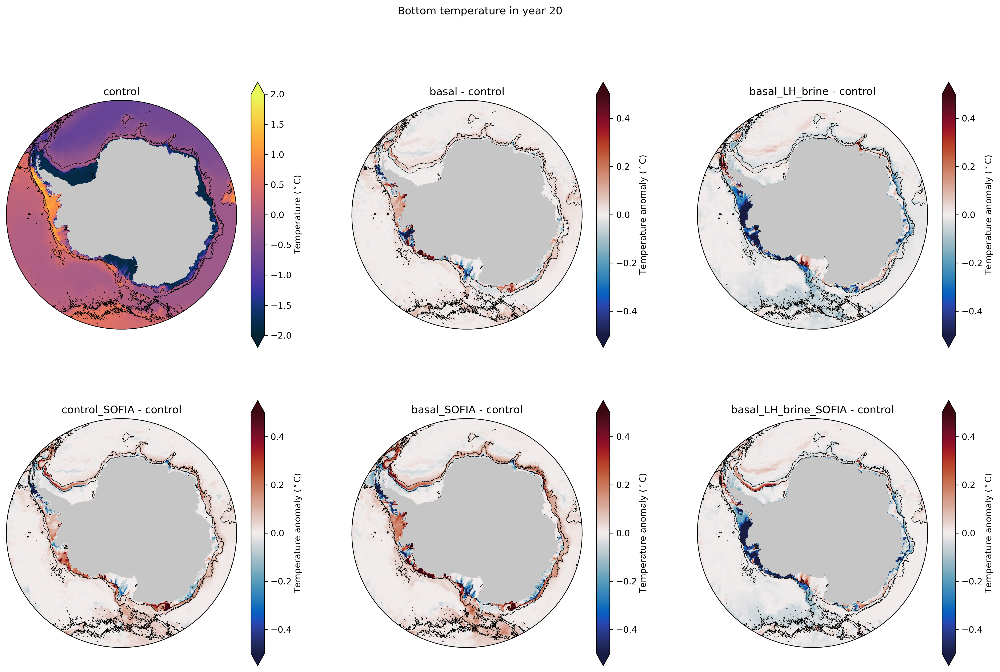

In [14]:
fig, axes = plt.subplots(nrows = 2, ncols = 3, figsize = (20,12),subplot_kw=dict(projection=ccrs.SouthPolarStereo()), dpi = 300)
control_temp = plot_circumpolar_map_mean_T(axes[0,0], 'control', 2, -2, depth = 'bottom')
plot_circumpolar_map_mean_T(axes[1,0], 'control_SOFIA', 0.5, -0.5, depth = 'bottom', anomaly = True, ref = control_temp, refname = 'control')
plot_circumpolar_map_mean_T(axes[0,1], 'basal', 0.5, -0.5, depth = 'bottom', anomaly = True, ref = control_temp, refname = 'control')
plot_circumpolar_map_mean_T(axes[1,1], 'basal_SOFIA', 0.5, -0.5, depth = 'bottom', anomaly = True, ref = control_temp, refname = 'control')
plot_circumpolar_map_mean_T(axes[0,2], 'basal_LH_brine', 0.5, -0.5, depth = 'bottom', anomaly = True, ref = control_temp, refname = 'control')
plot_circumpolar_map_mean_T(axes[1,2], 'basal_LH_brine_SOFIA', 0.5, -0.5, depth = 'bottom', anomaly = True, ref = control_temp, refname = 'control')

fig.suptitle('Bottom temperature in year 20')

check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12


Exception ignored in: <function CachingFileManager.__del__ at 0x145632173740>
Traceback (most recent call last):
  File "/g/data/xp65/public/apps/med_conda/envs/analysis3-25.07/lib/python3.11/site-packages/xarray/backends/file_manager.py", line 250, in __del__
    self.close(needs_lock=False)
  File "/g/data/xp65/public/apps/med_conda/envs/analysis3-25.07/lib/python3.11/site-packages/xarray/backends/file_manager.py", line 234, in close
    file.close()
  File "src/netCDF4/_netCDF4.pyx", line 2669, in netCDF4._netCDF4.Dataset.close
  File "src/netCDF4/_netCDF4.pyx", line 2636, in netCDF4._netCDF4.Dataset._close
  File "src/netCDF4/_netCDF4.pyx", line 2164, in netCDF4._netCDF4._ensure_nc_success
RuntimeError: NetCDF: Not a valid ID


check year 20 has 12 months: no months =  12


Exception ignored in: <function CachingFileManager.__del__ at 0x145632173740>
Traceback (most recent call last):
  File "/g/data/xp65/public/apps/med_conda/envs/analysis3-25.07/lib/python3.11/site-packages/xarray/backends/file_manager.py", line 250, in __del__
    self.close(needs_lock=False)
  File "/g/data/xp65/public/apps/med_conda/envs/analysis3-25.07/lib/python3.11/site-packages/xarray/backends/file_manager.py", line 234, in close
    file.close()
  File "src/netCDF4/_netCDF4.pyx", line 2669, in netCDF4._netCDF4.Dataset.close
  File "src/netCDF4/_netCDF4.pyx", line 2636, in netCDF4._netCDF4.Dataset._close
  File "src/netCDF4/_netCDF4.pyx", line 2164, in netCDF4._netCDF4._ensure_nc_success
RuntimeError: NetCDF: Not a valid ID


Text(0.5, 0.98, 'Bottom temperature in year 20')

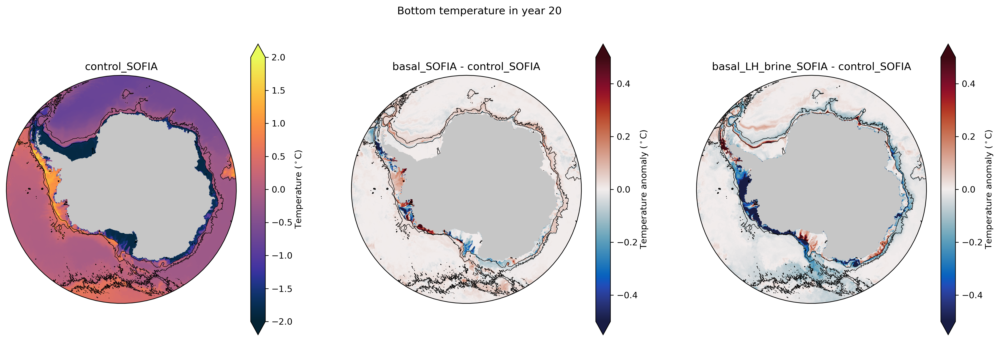

In [16]:
fig, axes = plt.subplots(nrows = 1, ncols = 3, figsize = (20,6),subplot_kw=dict(projection=ccrs.SouthPolarStereo()), dpi = 300)
control_temp_SOFIA = plot_circumpolar_map_mean_T(axes[0], 'control_SOFIA', 2, -2, depth = 'bottom')
plot_circumpolar_map_mean_T(axes[1], 'basal_SOFIA', 0.5, -0.5, depth = 'bottom', anomaly = True, ref = control_temp_SOFIA, refname = 'control_SOFIA')
plot_circumpolar_map_mean_T(axes[2], 'basal_LH_brine_SOFIA', 0.5, -0.5, depth = 'bottom', anomaly = True, ref = control_temp_SOFIA, refname = 'control_SOFIA')

fig.suptitle('Bottom temperature in year 20')

## Surface Salinity

check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12


Text(0.5, 0.98, 'Surface salinity in year 20')

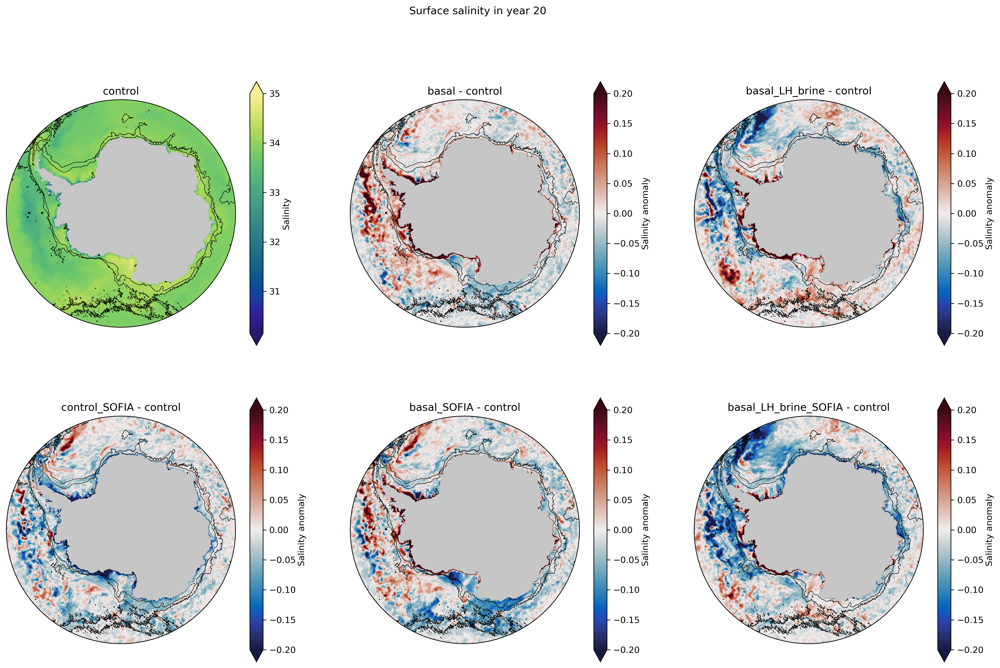

In [9]:
fig, axes = plt.subplots(nrows = 2, ncols = 3, figsize = (20,12),subplot_kw=dict(projection=ccrs.SouthPolarStereo()), dpi = 300)
control_salt = plot_circumpolar_map_mean_S(axes[0,0], 'control', 33.5,35)
plot_circumpolar_map_mean_S(axes[1,0], 'control_SOFIA', 0.2, -0.2, anomaly = True, ref = control_salt, refname = 'control')
plot_circumpolar_map_mean_S(axes[0,1], 'basal', 0.2, -0.2, anomaly = True, ref = control_salt, refname = 'control')
plot_circumpolar_map_mean_S(axes[1,1], 'basal_SOFIA', 0.2, -0.2, anomaly = True, ref = control_salt, refname = 'control')
plot_circumpolar_map_mean_S(axes[0,2], 'basal_LH_brine', 0.2, -0.2, anomaly = True, ref = control_salt, refname = 'control')
plot_circumpolar_map_mean_S(axes[1,2], 'basal_LH_brine_SOFIA', 0.2, -0.2, anomaly = True, ref = control_salt, refname = 'control')

fig.suptitle('Surface salinity in year 20')

In [ ]:
fig, axes = plt.subplots(nrows = 1, ncols = 3, figsize = (20,6),subplot_kw=dict(projection=ccrs.SouthPolarStereo()), dpi = 300)
control_salt_SOFIA = plot_circumpolar_map_mean_S(axes[0], 'control_SOFIA', 33.5,35)
plot_circumpolar_map_mean_S(axes[1], 'basal_SOFIA', 0.2, -0.2, anomaly = True, ref = control_temp_SOFIA, refname = 'control_SOFIA')
plot_circumpolar_map_mean_S(axes[2], 'basal_LH_brine_SOFIA', 0.2, -0.2, anomaly = True, ref = control_temp_SOFIA, refname = 'control_SOFIA')

fig.suptitle('Surface salinity in year 20')

## Bottom Salinity

check year 20 has 12 months: no months =  12


/g/data/xp65/public/apps/med_conda/envs/analysis3-25.07/lib/python3.11/site-packages/dask/array/reductions.py:324: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/g/data/xp65/public/apps/med_conda/envs/analysis3-25.07/lib/python3.11/site-packages/dask/array/reductions.py:324: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/g/data/xp65/public/apps/med_conda/envs/analysis3-25.07/lib/python3.11/site-packages/dask/array/reductions.py:324: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/g/data/xp65/public/apps/med_conda/envs/analysis3-25.07/lib/python3.11/site-packages/dask/array/reductions.py:324: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


check year 20 has 12 months: no months =  12


/g/data/xp65/public/apps/med_conda/envs/analysis3-25.07/lib/python3.11/site-packages/dask/array/reductions.py:324: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12
check year 20 has 12 months: no months =  12


Text(0.5, 0.98, 'Bottom salinity in year 20')

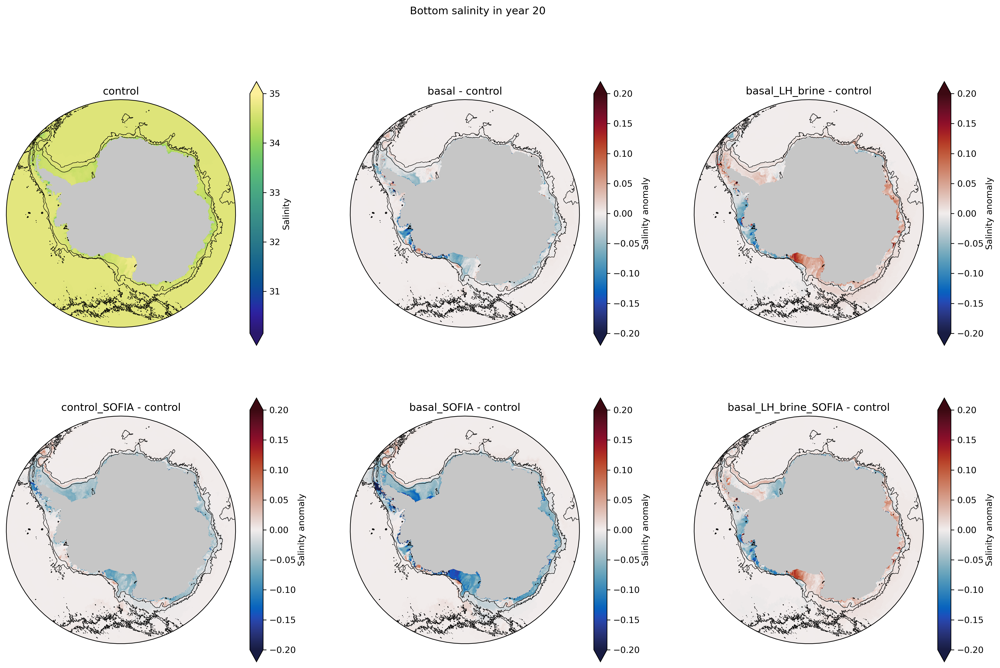

In [12]:
fig, axes = plt.subplots(nrows = 2, ncols = 3, figsize = (20,12),subplot_kw=dict(projection=ccrs.SouthPolarStereo()), dpi = 300)
control_salt = plot_circumpolar_map_mean_S(axes[0,0], 'control', 33.5,35, depth = 'bottom')
plot_circumpolar_map_mean_S(axes[1,0], 'control_SOFIA', 0.2, -0.2, depth = 'bottom', anomaly = True, ref = control_salt, refname = 'control')
plot_circumpolar_map_mean_S(axes[0,1], 'basal', 0.2, -0.2, depth = 'bottom', anomaly = True, ref = control_salt, refname = 'control')
plot_circumpolar_map_mean_S(axes[1,1], 'basal_SOFIA', 0.2, -0.2, depth = 'bottom', anomaly = True, ref = control_salt, refname = 'control')
plot_circumpolar_map_mean_S(axes[0,2], 'basal_LH_brine', 0.2, -0.2, depth = 'bottom', anomaly = True, ref = control_salt, refname = 'control')
plot_circumpolar_map_mean_S(axes[1,2], 'basal_LH_brine_SOFIA', 0.2, -0.2, depth = 'bottom', anomaly = True, ref = control_salt, refname = 'control')

fig.suptitle('Bottom salinity in year 20')

In [ ]:
fig, axes = plt.subplots(nrows = 1, ncols = 3, figsize = (20,6),subplot_kw=dict(projection=ccrs.SouthPolarStereo()), dpi = 300)
control_salt_SOFIA = plot_circumpolar_map_mean_S(axes[0], 'control_SOFIA', 33.5,35, depth = 'bottom')
plot_circumpolar_map_mean_S(axes[1], 'basal_SOFIA', 0.2, -0.2, depth = 'bottom', anomaly = True, ref = control_salt_SOFIA, refname = 'control_SOFIA')
plot_circumpolar_map_mean_S(axes[2], 'basal_LH_brine_SOFIA', 0.2, -0.2, depth = 'bottom', anomaly = True, ref = control_salt_SOFIA, refname = 'control_SOFIA')

fig.suptitle('Bottom salinity in year 20')